<a href="https://colab.research.google.com/github/sirishacyd/machinelearning/blob/main/SirishaPolisetty_Clustering_KMeans_CMPE257Sep3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Clustering : California Housing Dataset



## CMPE 257 Machine Learning
### Instructor : Dr. Ali Asaranjani
### Student Name : Sirisha Polisetty
### Assignment 1 : Clustering K-Means using scikit and Pytorch



### Business Objective

Given a housing dataset for California, our aim is to:
- Understand the structure of the housing market.
- Identify geographical clusters with similar housing characteristics.
- Explore the relationship between geographical proximity to the ocean and housing value.

These insights could be valuable for real estate investors, homebuyers, or policy makers to make informed decisions.



## Dataset

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
url = "https://raw.githubusercontent.com/sirishacyd/machinelearning/main/housing.csv"
df = pd.read_csv(url)

# Check first few rows of the dataset
df.head()


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


### Data Cleaning

Before diving into the clustering, let's check for any missing values and handle them appropriately.


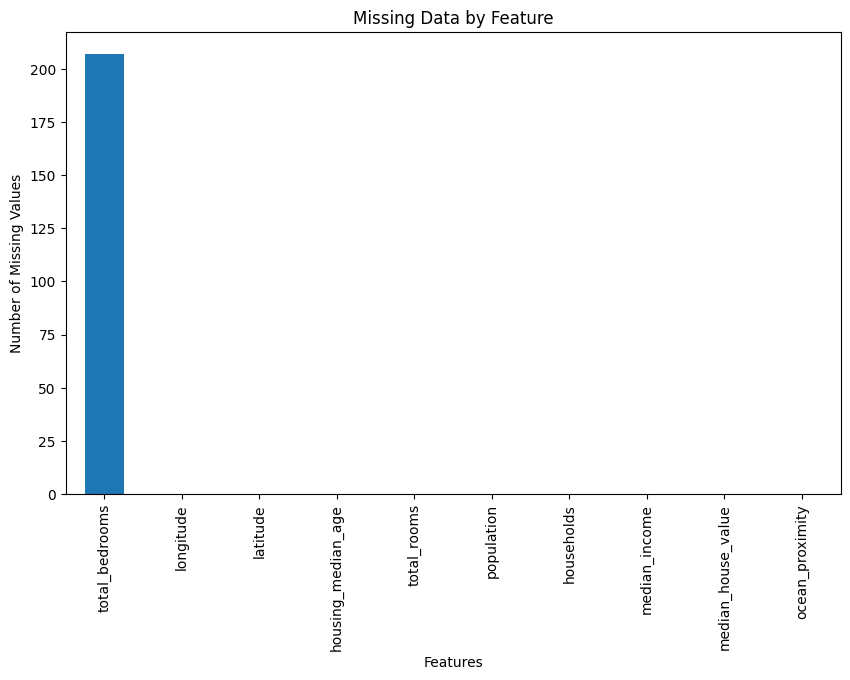

In [ ]:
# Check for missing values
missing_values = df.isnull().sum()
missing_values
# Plot missing values
plt.figure(figsize=(10, 6))
missing_values.sort_values(ascending=False).plot(kind='bar')
plt.title('Missing Data by Feature')
plt.ylabel('Number of Missing Values')
plt.xlabel('Features')
plt.show()

In [ ]:
# Impute missing values for 'total_bedrooms' with median of that column
df['total_bedrooms'].fillna(df['total_bedrooms'].median(), inplace=True)

# Verify if all missing values are addressed
df.isnull().sum()


longitude             0
latitude              0
housing_median_age    0
total_rooms           0
total_bedrooms        0
population            0
households            0
median_income         0
median_house_value    0
ocean_proximity       0
dtype: int64

### Exploratory Data Analysis

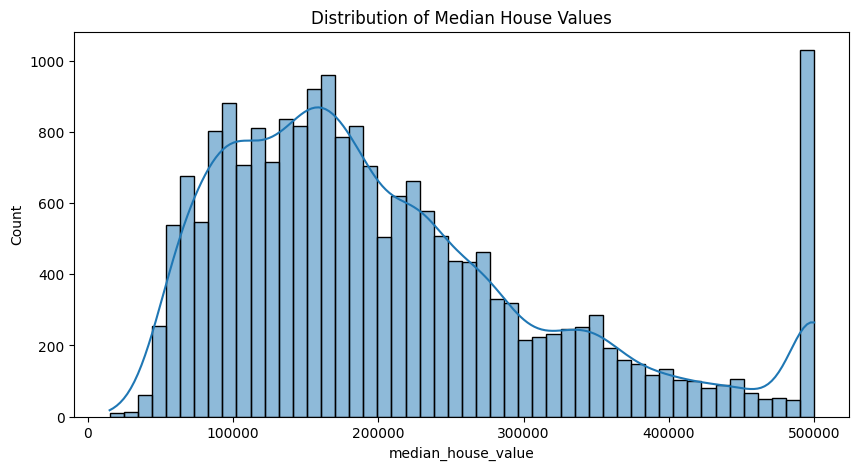

In [ ]:
# Distribution of median house values
plt.figure(figsize=(10, 5))
sns.histplot(df['median_house_value'], bins=50, kde=True)
plt.title("Distribution of Median House Values")
plt.show()


# Clustering : K-Means



### Elbow Method Observation

From the elbow method, we look for a point where the inertia starts to level off. This gives us an indication of the optimal number of clusters. Based on the graph, it looks like after X clusters (replace X with the identified optimal number), the decrease in inertia slows down, indicating that X might be the optimal number of clusters.


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

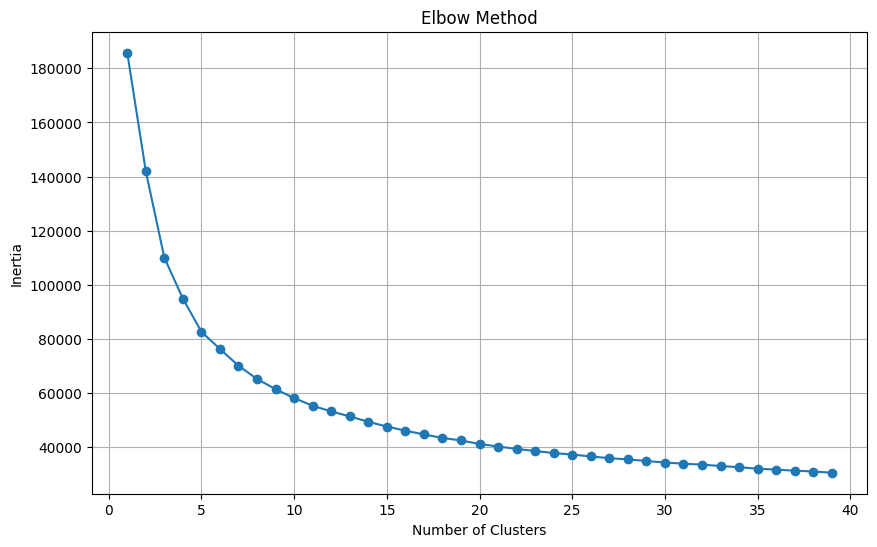

In [ ]:
# Determine the optimal number of clusters using the elbow method
inertia_values = []
range_values = range(1, 40)
for i in range_values:
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(scaled_data)
    inertia_values.append(kmeans.inertia_)

# Plotting the elbow curve
plt.figure(figsize=(10,6))
plt.plot(range_values, inertia_values, 'o-')
plt.title("Elbow Method")
plt.xlabel("Number of Clusters")
plt.ylabel("Inertia")
plt.grid(True)
plt.show()


## Clustering - KMeans with Scikit-Learn

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


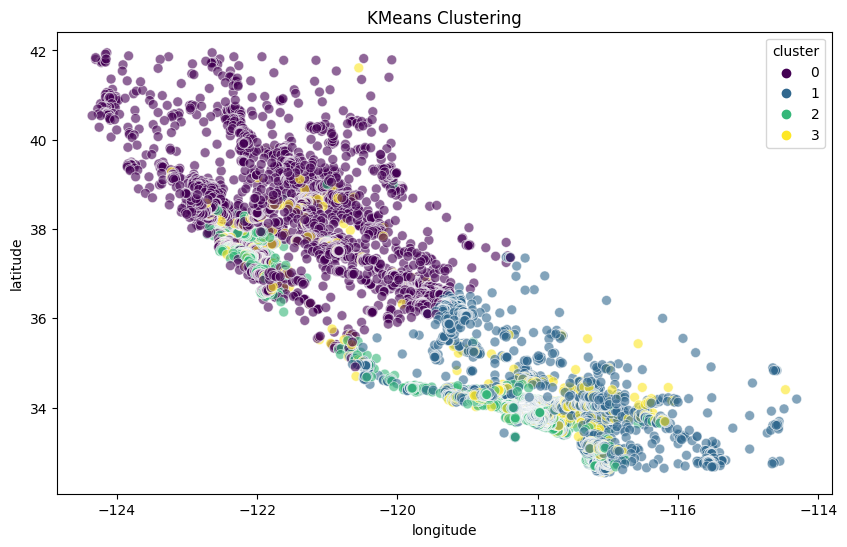

In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Prepare data for clustering: use numerical columns and exclude 'ocean_proximity' for now
data_for_clustering = df.drop(['ocean_proximity'], axis=1)

# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(data_for_clustering)

# Perform KMeans clustering
kmeans = KMeans(n_clusters=4, random_state=42)
df['cluster'] = kmeans.fit_predict(scaled_data)

# Visualizing clusters using latitude and longitude
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df['longitude'], y=df['latitude'], hue=df['cluster'], palette="viridis", s=50, alpha=0.6)
plt.title('KMeans Clustering')
plt.show()


In [ ]:
import folium
from folium.plugins import MarkerCluster

# Define a base map with a starting point being the mean of the latitudes and longitudes
m = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=6)

# Create a marker cluster
marker_cluster = MarkerCluster().add_to(m)

# Loop through the dataset and add each data point to the mark cluster
for idx, row in df.iterrows():
    # We can use a popup to display additional information on each marker
    popup = folium.Popup(f"Median House Value: ${row['median_house_value']}", parse_html=True)

    # The color of markers will change based on the house value
    if row['median_house_value'] > 400000:
        color = "red"
    elif row['median_house_value'] > 250000:
        color = "blue"
    else:
        color = "red"

    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=5,
        color=color,
        popup=popup,
        fill=True,
        fill_color=color
    ).add_to(marker_cluster)

m



## Clustering - KMeans with Pytorch


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


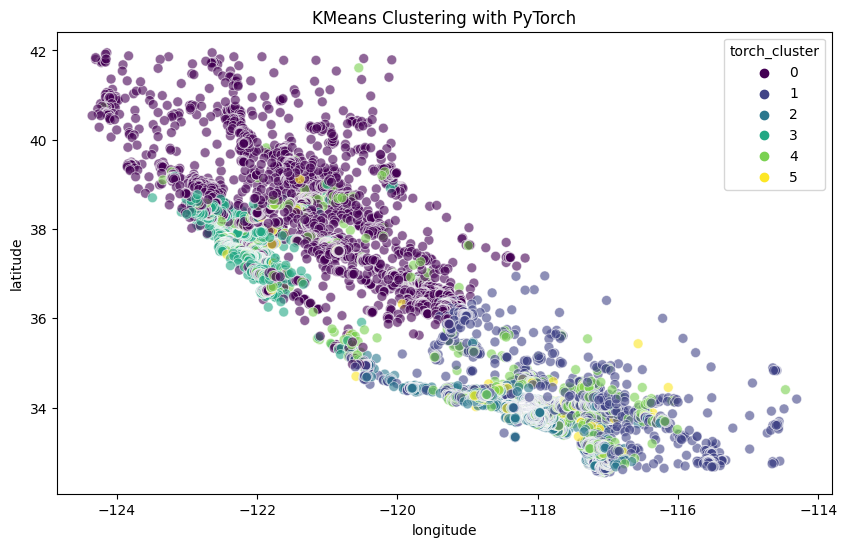

In [ ]:
import torch
from sklearn.cluster import KMeans as TorchKMeans

# Convert data to tensor
tensor_data = torch.Tensor(scaled_data)

# KMeans with PyTorch
kmeans_torch = TorchKMeans(n_clusters=6, random_state=42)
df['torch_cluster'] = kmeans_torch.fit_predict(tensor_data)

# Visualizing clusters using latitude and longitude
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df['longitude'], y=df['latitude'], hue=df['torch_cluster'], palette="viridis", s=50, alpha=0.6)
plt.title('KMeans Clustering with PyTorch')
plt.show()


## DBSCAN Clustering with Scikit-Learn

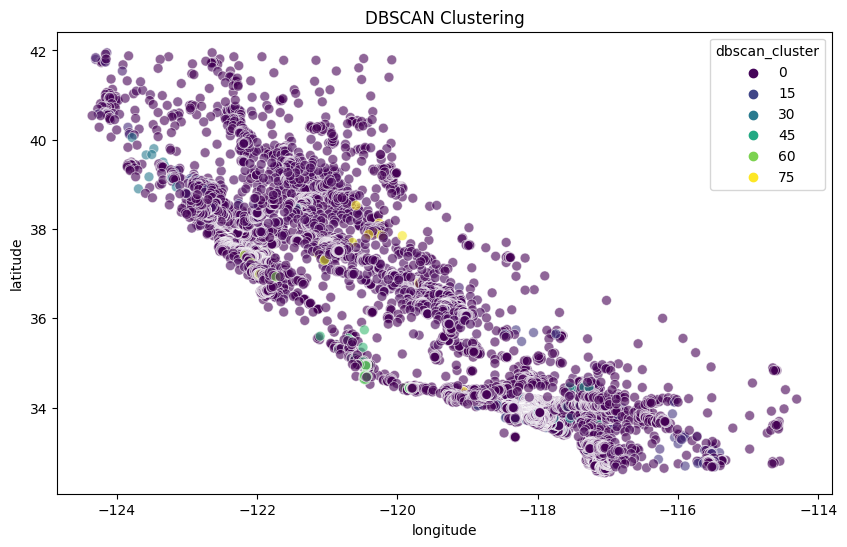

In [ ]:
from sklearn.cluster import DBSCAN

# Apply DBSCAN clustering
dbscan = DBSCAN(eps=0.5, min_samples=5)
df['dbscan_cluster'] = dbscan.fit_predict(scaled_data)

# Visualizing clusters using latitude and longitude
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df['longitude'], y=df['latitude'], hue=df['dbscan_cluster'], palette="viridis", s=50, alpha=0.6)
plt.title('DBSCAN Clustering')
plt.show()

### DBSCAN Observations

DBSCAN (Density-Based Spatial Clustering of Applications with Noise) does not require us to specify the number of clusters. It works based on the density of data points. Points that are closely packed together are considered a single cluster, and areas where points are sparse are considered to be noise or border points.

From the visualization, we can observe that:
1. There are certain dense regions that DBSCAN has identified as clusters.
2. There are areas marked with a particular color (often -1) which indicates noise or border points.

This kind of clustering can be particularly useful when our data has uneven cluster sizes or non-globular shapes.


# Interpretation and Conclusion

From the clustering results, we observe that:
1. There are distinct regions in California with specific housing characteristics.
2. Clusters may be related to geographical features, proximity to urban centers, or proximity to the ocean.

Further investigation could be carried out to ascertain the specific characteristics of each cluster.
